# Hamiltonian Monte Carlo Assignment

### Sampling from a tri-model mixture of Gaussians in $\mathbb{R}^2$

2018-10-19 &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp; Guy Davidson &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp; IL181.014 - Professor Carl Scheffler

Starting with some quick notebook setup:

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import hamiltonian_monte_carlo as hmc
import diagnostics
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import patches
from matplotlib import path as mpath
import pickle

## Defining the toy problem

As defined above, a mixture of three Gaussians in $\mathbb{R}^2$:
    
$$ P(\vec{\theta}) \sim \frac{1}{2} \mathcal{N} (\left[ \begin{smallmatrix} 2 \\ 12\end{smallmatrix} \right], \left[ \begin{smallmatrix} 2 & 0.5 \\ 0.5 & 1 \end{smallmatrix} \right]) + \frac{1}{4}\mathcal{N} (\left[ \begin{smallmatrix} 10 \\ -8 \end{smallmatrix} \right], \left[ \begin{smallmatrix} 1 & 0.9 \\ 0.9 & 2 \end{smallmatrix} \right]) + \frac{1}{4}\mathcal{N} (\left[ \begin{smallmatrix} -12 \\ -9 \end{smallmatrix} \right], \left[ \begin{smallmatrix} 0.5 & 0 \\ 0 & 0.5 \end{smallmatrix} \right])  $$

In [3]:
def two_d_mixture_gaussians(theta):
    return hmc.np.log(0.5 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([2, 12]),
                                                          cov=hmc.np.array(([[2, 0.5], [0.5, 1]]))) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([10, -8]),
                                                           cov=hmc.np.array(([[1, 0.9], [0.9, 2]]))) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([-12, -9]),
                                                           cov=hmc.np.array(([[0.5, 0], [0, 0.5]]))))

Let's plot it:

In [36]:
DEFAULT_COLORMAP = 'Paired'


def sample_and_plot(sample_generating_function, num_chains, log_density,
                    first_param_limits, second_param_limits, suptitle='', 
                    temperature=1.0, warmup_proportion=0.5, colormap_name=DEFAULT_COLORMAP):
    all_samples = []
    all_theta_samples = []
    
    for i in range(num_chains):
        samples = sample_generating_function()
        all_samples.append(np.copy(samples))
        theta_samples = np.stack(np.ndarray.flatten(samples[:, 0]))
        all_theta_samples.append(np.copy(theta_samples))
        
    two_d_countour_plot(log_density, num_chains, first_param_limits, second_param_limits,
                        all_samples, all_theta_samples, suptitle, 
                        warmup_proportion, temperature, colormap_name)
    
    return all_samples, all_theta_samples


def two_d_countour_plot(log_density, num_chains, first_param_limits, second_param_limits,
                        all_samples, all_theta_samples, suptitle='', warmup_propotion=0.5,
                        temperature=1.0, colormap_name=DEFAULT_COLORMAP):
    theta_one_values = np.linspace(first_param_limits[0], first_param_limits[1], 100)
    theta_two_values = np.linspace(second_param_limits[0], second_param_limits[1], 100)
    
    theta_one_grid, theta_two_grid = np.meshgrid(theta_one_values, theta_two_values)
    theta_grid = np.stack((theta_one_grid, theta_two_grid), axis=2)
    contour_values = log_density(theta_grid) / temperature
    
    plt.figure(figsize=(12, 12))
    plt.contour(theta_one_grid, theta_two_grid, contour_values, 30)
    
    if num_chains > 0:    
        real_sample_start = int(all_theta_samples[0].shape[0] * warmup_propotion)
        colormap = plt.get_cmap(colormap_name)
        
        for i in range(num_chains):
            sample_colors = all_samples[i][:,2].astype(np.int32) + (2 * i)
            sample_colors = [colormap.colors[x] for x in sample_colors]
            plt.scatter(all_theta_samples[i][real_sample_start:,0], 
                        all_theta_samples[i][real_sample_start:,1], 
                        c=sample_colors[real_sample_start:], label=f'Chain #{i+1}')

        legend = plt.legend(loc='best')
        for i in range(num_chains):
            legend.legendHandles[i].set_color(colormap.colors[(2 * i) + 1])

        theta_samples = np.asarray(all_theta_samples)[:, real_sample_start:, :]
        ess = diagnostics.effective_sample_size(theta_samples)
        rhat = diagnostics.split_r_hat(theta_samples)

        with np.printoptions(precision=5, suppress=True):
            plt.title(f'Sampling results, {all_theta_samples[0].shape[0] - real_sample_start} post-warm-up samples, ESS = {ess}, $\\hat{{R}}$ = {rhat}')
    
    plt.suptitle(suptitle, size=20, y=0.93)
    
    plt.show()
    
def MH_two_d_countour_plot(log_density, num_chains, first_param_limits, second_param_limits,
                           all_samples, all_theta_samples, suptitle='', warmup_propotion=0.5,
                           colormap_name=DEFAULT_COLORMAP):
    theta_one_values = np.linspace(first_param_limits[0], first_param_limits[1], 100)
    theta_two_values = np.linspace(second_param_limits[0], second_param_limits[1], 100)
    
    theta_one_grid, theta_two_grid = np.meshgrid(theta_one_values, theta_two_values)
    theta_grid = np.stack((theta_one_grid, theta_two_grid), axis=2)
    contour_values = log_density(theta_grid)
    
    real_sample_start = int(all_theta_samples[0].shape[0] * warmup_propotion)
        
    colormap = plt.get_cmap(colormap_name)
    plt.figure(figsize=(12, 12))
    plt.contour(theta_one_grid, theta_two_grid, contour_values, 30)
    for i in range(num_chains):
        sample_colors = all_samples[i][:,1].astype(np.int32) + (2 * i)
        sample_colors = [colormap.colors[x] for x in sample_colors]
        plt.scatter(all_theta_samples[i][real_sample_start:,0], 
                    all_theta_samples[i][real_sample_start:,1], 
                    c=sample_colors[real_sample_start:], label=f'Chain #{i+1}')
        
    legend = plt.legend(loc='best')
    for i in range(num_chains):
        legend.legendHandles[i].set_color(colormap.colors[(2 * i) + 1])
        
    theta_samples = np.asarray(all_theta_samples)[:, real_sample_start:, :]
    ess = diagnostics.effective_sample_size(theta_samples)
    rhat = diagnostics.split_r_hat(theta_samples)
    
    with np.printoptions(precision=5, suppress=True):
        plt.title(f'Sampling results, {all_theta_samples[0].shape[0] - real_sample_start} post-warm-up samples, ESS = {ess}, $\\hat{{R}}$ = {rhat}')
    
    plt.suptitle(suptitle, size=20, y=0.93)
    
    plt.show()
    

def plot_results(results, key, suptitle, density=two_d_mixture_gaussians, 
                 plot_func=two_d_countour_plot, **kwargs):
    all_samples, all_theta_samples = results[key]
    num_chains = len(all_samples)
    plot_func(density, num_chains, [-20, 20], [-20, 20], 
              all_samples, all_theta_samples, suptitle, **kwargs)
    

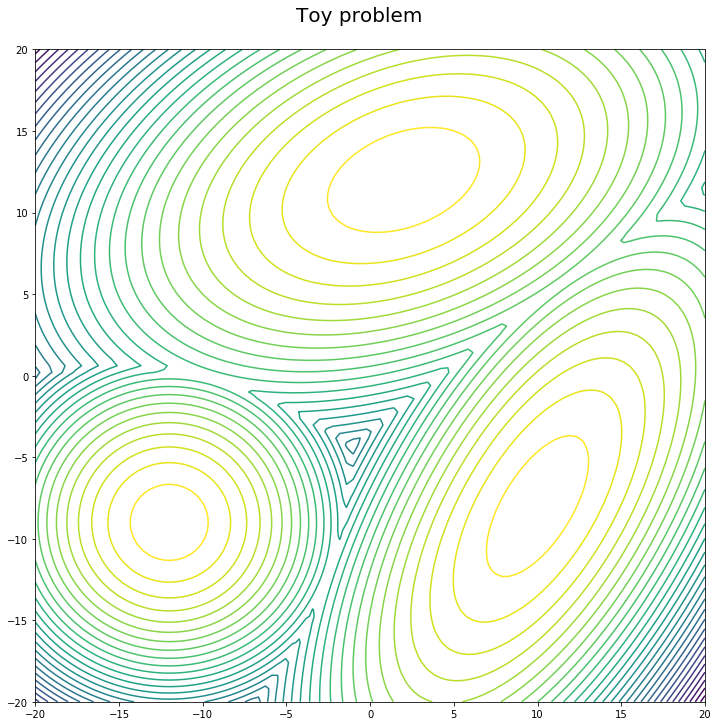

In [10]:
two_d_countour_plot(two_d_mixture_gaussians, 0, [-20, 20], [-20, 20], None, None, f'Toy problem')

Load saved results -- I ran a whole bunch of simulations:

In [13]:
with open('results.pickle', 'rb') as f:
        results = pickle.load(f)
        
print(results.keys())

dict_keys([(0.2, 400), (0.2, 800), (0.8, 400), (1.6, 400), ('MH', 1.0), ('MH', 2.0), ('MH', 4.0), ('MH', 2.0, 2.0), ('MH', 2.0, 4.0), ('MH', 2.0, 8.0), ('MH', 2.0, 16.0), (1.0, 400, 2.0), ('HMC', 1.0, 400, 1.0, 2.0), ('HMC', 1.0, 400, 1.0, 4.0), ('HMC', 1.0, 400, 1.0, 8.0), ('HMC', 1.0, 400, 1.0, 16), ('HMC-relaxed', 1.0, 100, 1.0, 1.0), ('MH', 2.0, 'sinusodial temp'), ('MH', 1.0, 'sinusodial temp'), ('MH', 2.0, 'alternative sinusodial temp'), ('HMC-semi-relaxed', 1.0, 100, 1.0, 1.0), ('HMC', 1.0, 100, 5.0), ('HMC', 1.0, 100, 'bimodal momentum sampler'), ('HMC', 0.1, 100, 5.0), ('HMC', 0.01, 100, 5.0), ('HMC', 0.1, 100, 1.0), ('NUTS', 0.1, None, 1.0), ('HMC', 0.01, 100, 1.0), ('NUTS', 0.1, None, 2.0), ('HMC', 0.1, 100, 2.0), ('NUTS', 0.1, None, 3.0), ('NUTS', 0.1, None, 4.0), ('HMC', 0.1, 100, 3.0), ('HMC', 0.1, 100, 4.0), ('NUTS', 0.5, None, 1.0), ('NUTS', 0.5, None, 3.0), ('NUTS', 0.5, None, 5.0)])


I made an initial attempt with varying values of $\epsilon$ and $L$ leapfrog iterations, but nothing particularly seemed to make a difference (plotting a few below):

Note that the lighter color in each pair means a rejected sample, while the darker an accepted sample.

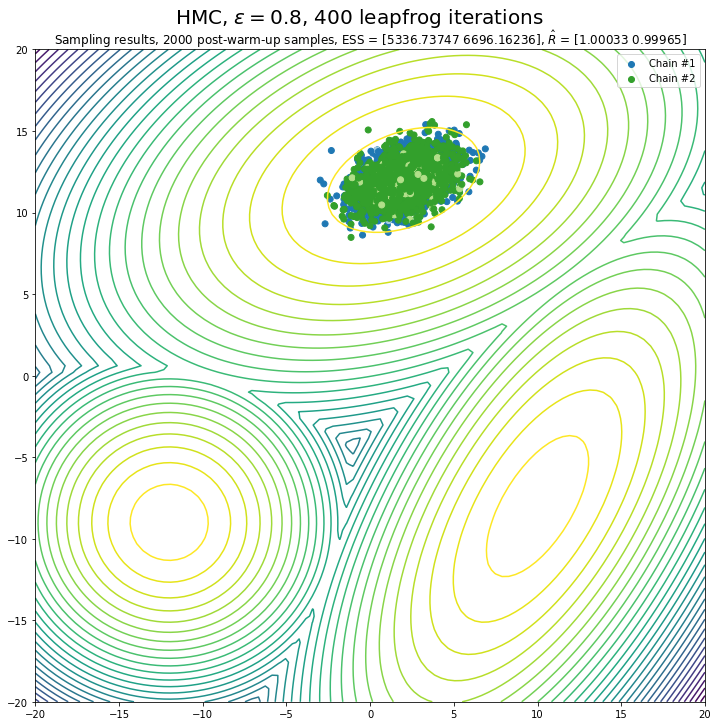

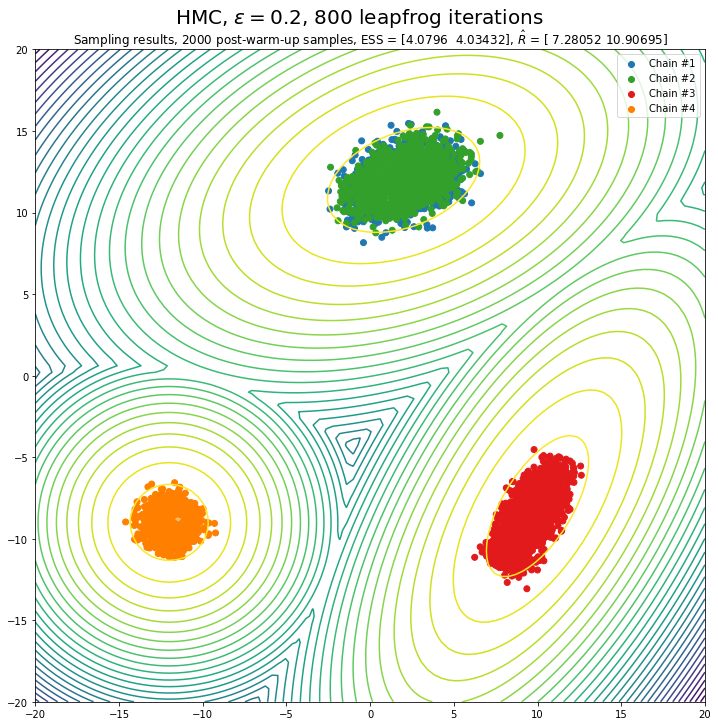

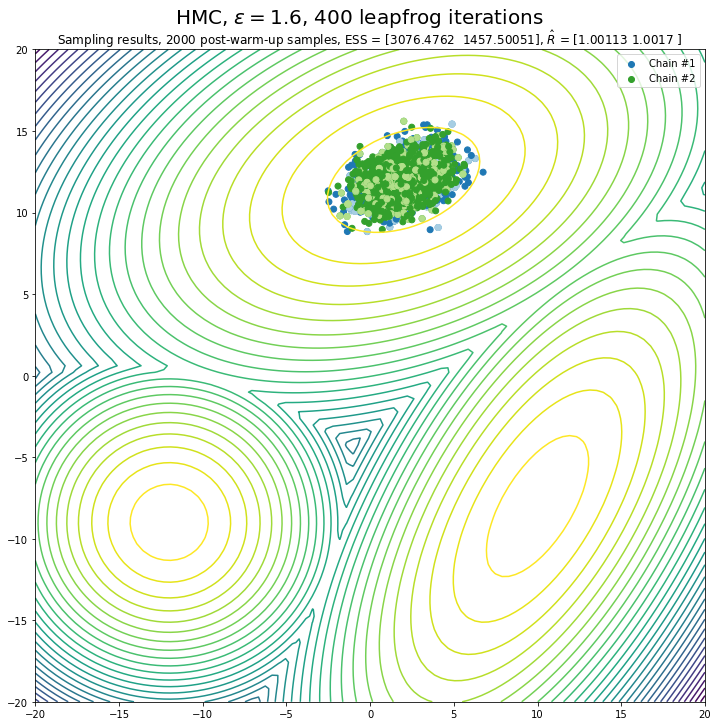

In [21]:
for epsilon, L in ((0.8, 400), (0.2, 800), (1.6, 400)):
    plot_results(results, (epsilon, L), 
             f'HMC, $\\epsilon = {epsilon}$, {L} leapfrog iterations')

Higher values of $\epsilon$ result in slightly more exploration around a particular mode, and more rejected samples, but no particularly better exploration of the different modes.

I implemented computing both $\hat{R}$ and the effective sample size, both reported above the graph. Due to some unclarity in the description provided in the Bayesian Data Analysis textbook (and perceived discrpencies with the PyStan implementation; see comments in the code), I'm not sure I trust my ESS, but I reasonably trust my $\hat{R}$, although I see values slightly below one, which is odd.

Either way, adding leapfrog iterations didn't seem to help (as using a tool like NUTS might predict, if it would suggest shorter trajectories before the reversal), and playing with $\epsilon$ doesn't help much either. Theoretically, we wouldn't expect these changes to make too much of a difference. As the Hamiltonian trajectory is supposed to explore the slice of state space around that same energy, moving to a larger epsilon would cause trajectories to range longer and accumulate more error, and adding leapfrog iterations would accomplish the same end. However, these parameters are easy to manipulate, so I started with them.

One quick question I had was how difficult would it be to make Metropolis-Hastings succesfully sample all three modes. I implemented it and ran it with a few parameter settings, staring by playing with the proposal standard deviation:

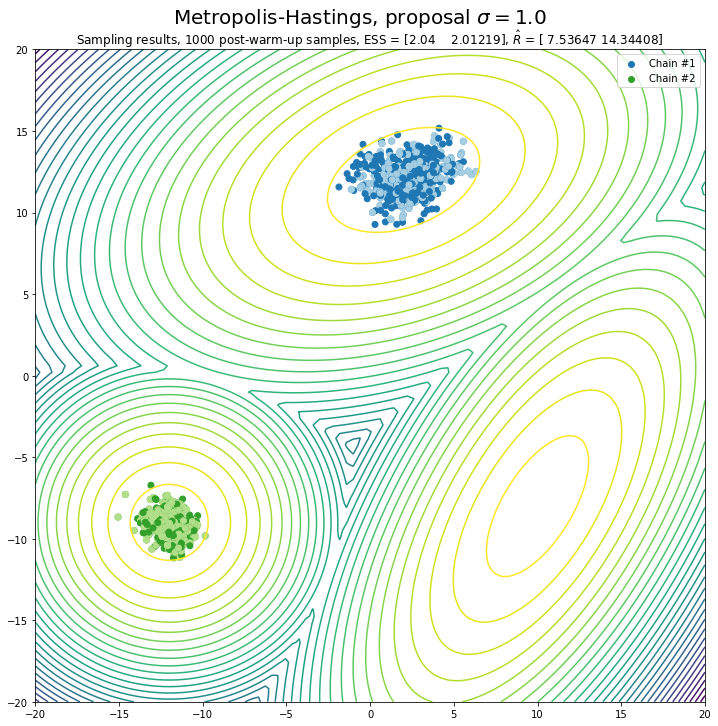

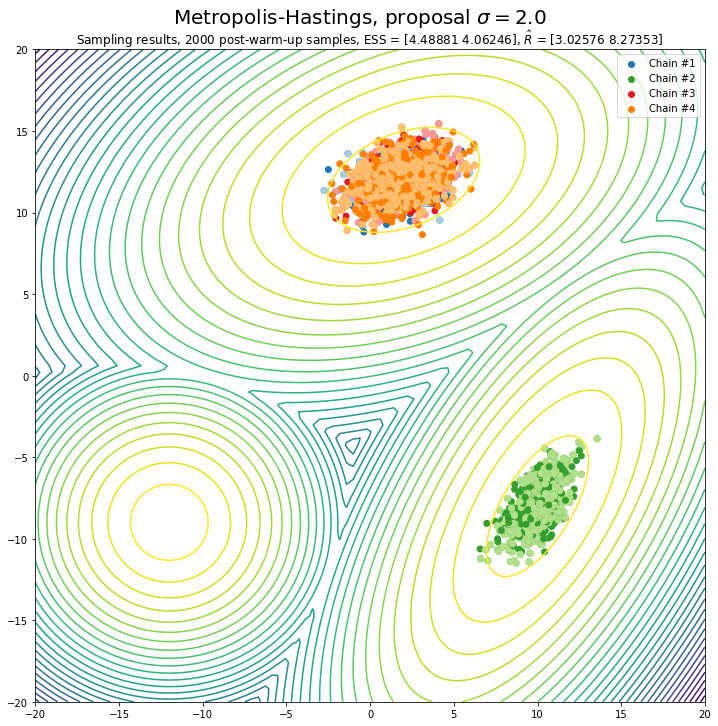

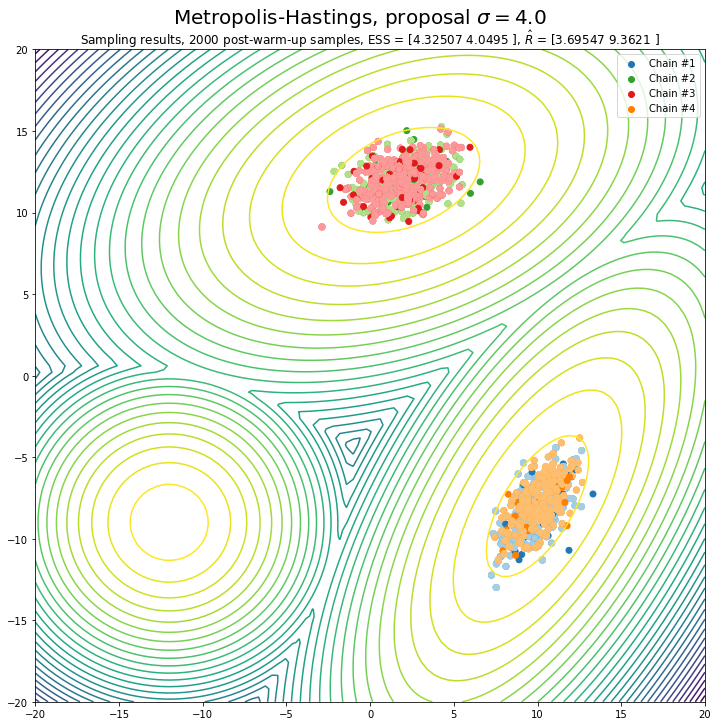

In [25]:
for proposal_std in (1.0, 2.0, 4.0):
    plot_results(results, ('MH', proposal_std),
                 f'Metropolis-Hastings, proposal $\\sigma = {proposal_std}$',
                plot_func=MH_two_d_countour_plot)

As the proposal $\sigma$ increases, we don't actually improve sampling performance all that much, exploring incrementally more around the means but rejecting far more samples, and not actually exploring much better.

One additional relaxation we can perform is changing the temperature -- essentially, relaxing the distribution, and increasing the deviation in energies that would result in an acceptable acceptance probability. Below we plot with similar values to one of the plots above, but $T \in \{2, 4, 8, 16\}$:

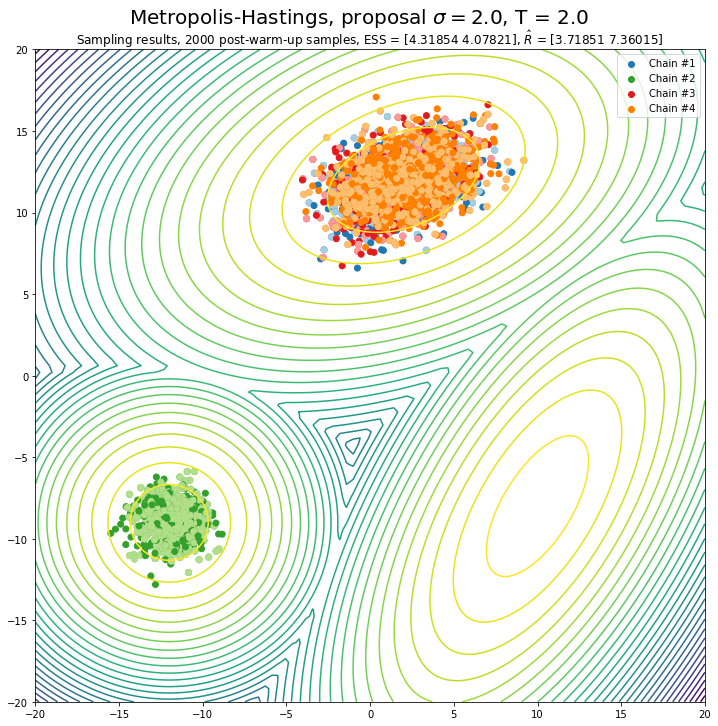

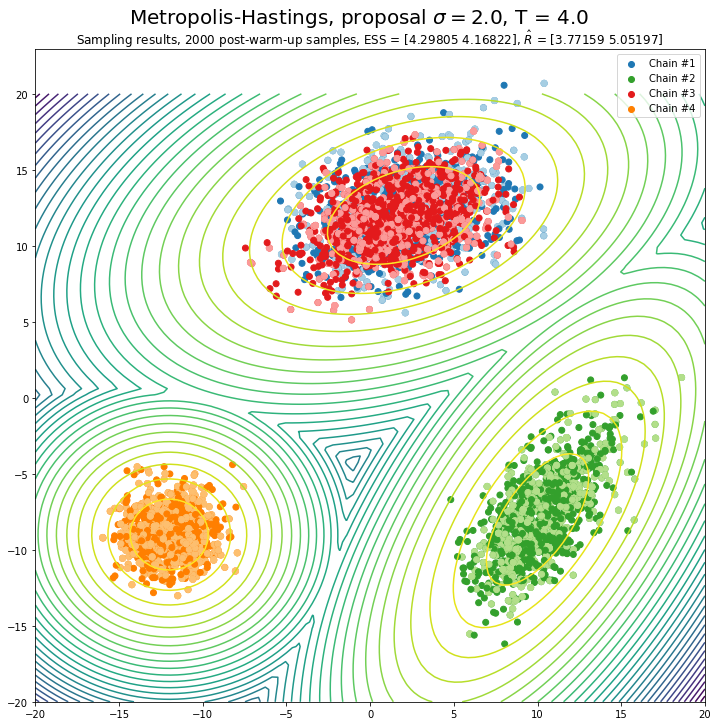

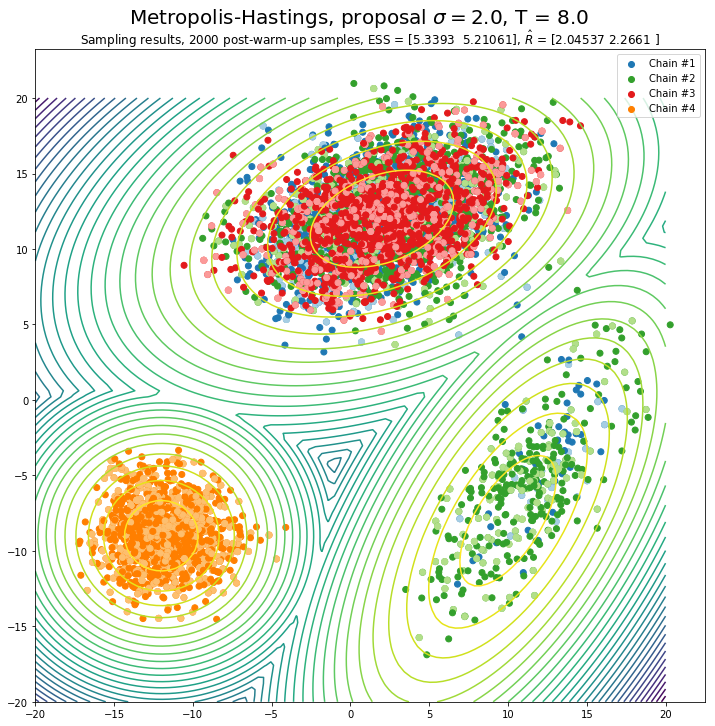

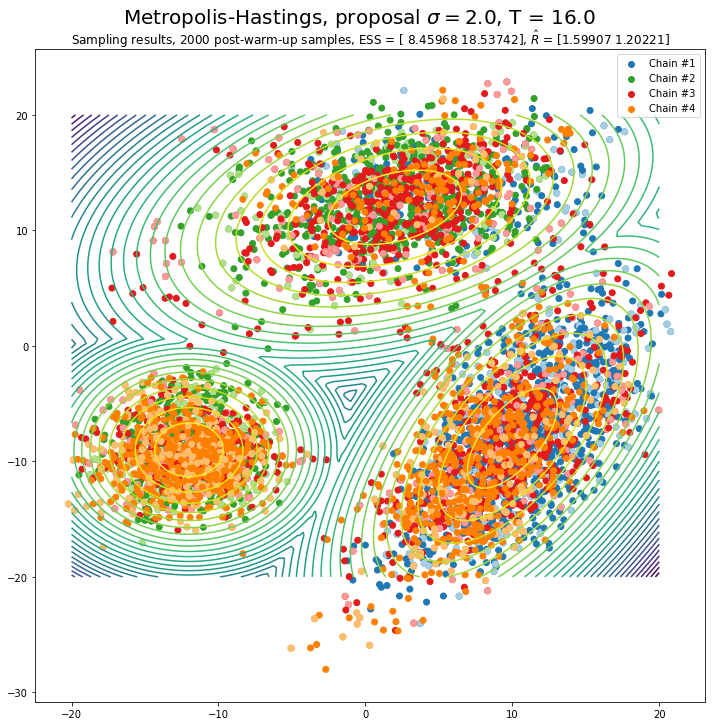

In [28]:
proposal_std = 2.0
for temperature in (2.0, 4.0, 8.0, 16.0):
    plot_results(results, ('MH', proposal_std, temperature),
                 f'Metropolis-Hastings, proposal $\\sigma = {proposal_std}$, T = {temperature}',
                plot_func=MH_two_d_countour_plot)

Unsurprisingly, increasing the temperature allows for substantial additional exploration. Most chains end up exploring all three modes, and showing better values of both $\hat{R}$ and my mildly untrustworthy ESS. I could change the contour plot scale, but I'll leave it to conform to the previous plots. 

The elegant thing about changing the temperature is that it can be done regardless of the target distribution sampled from. It requires no specific knowledge of the problem in order to show good results, making it a versetile debugging tool. 

However, there's no good reason to believe it would make much of a difference for HMC. In HMC it would only impact the computation of acceptance probabilities. However, since the Hamiltonian trajectory attempts to remain on a particular slice of energy space, it shouldn't help exploration too much. However, seeing is believing: 

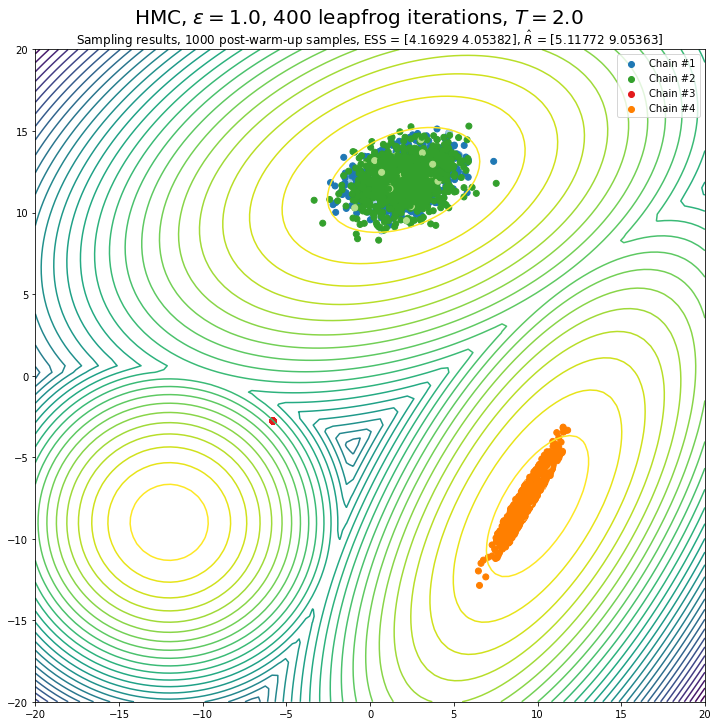

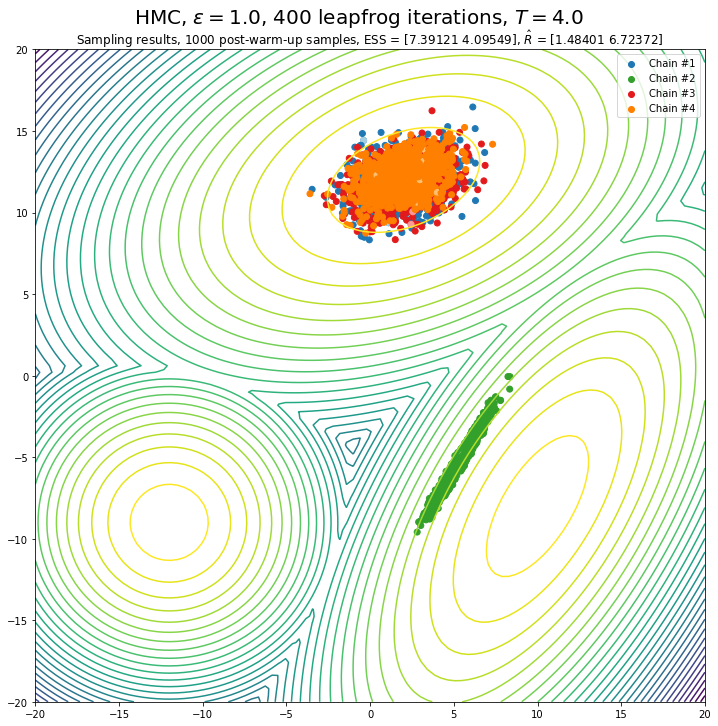

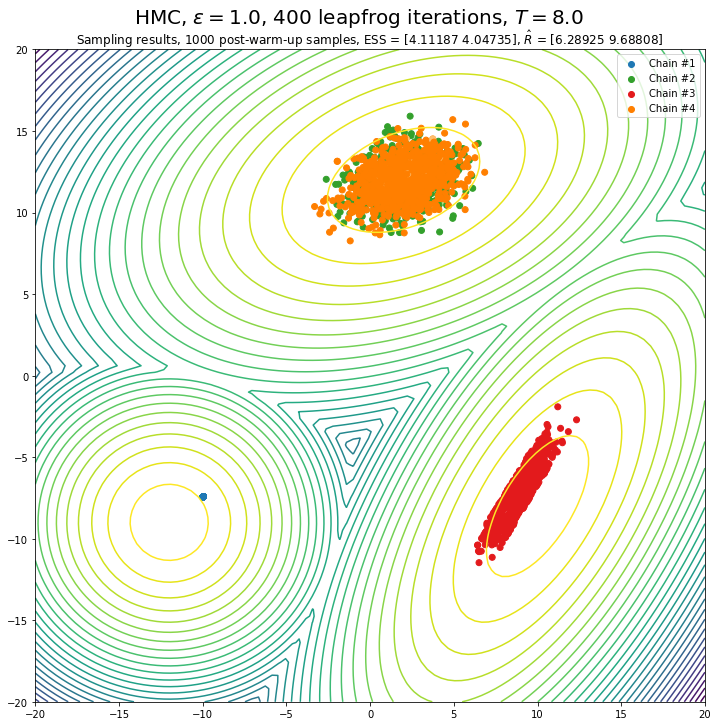

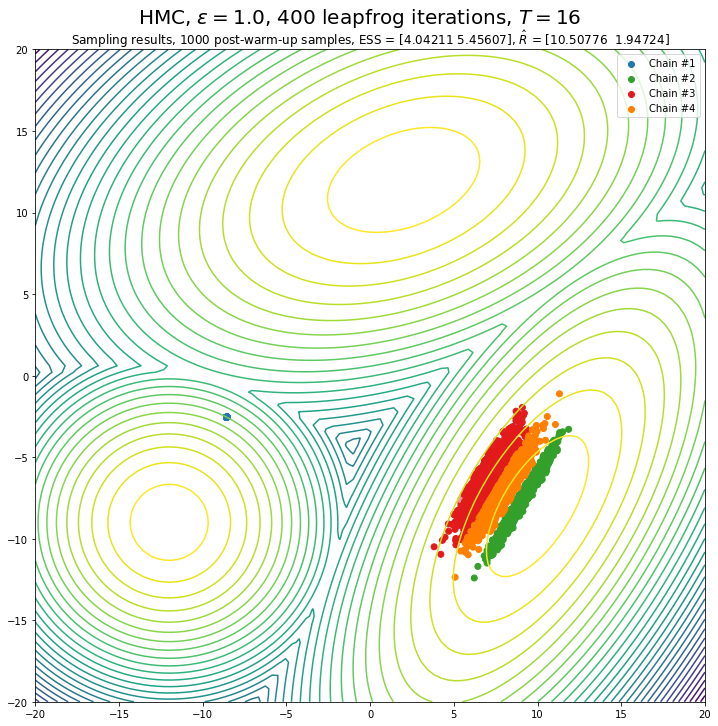

In [27]:
epsilon = 1.0
L = 400
for temperature in (2.0, 4.0, 8.0, 16):
    plot_results(results, ('HMC', epsilon, L, 1.0, temperature), 
             f'HMC, $\\epsilon = {epsilon}$, {L} leapfrog iterations, $T = {temperature}$')

It causes some 'smearing' of the samples, probably since the acceptance probabilities are flattened, but doesn't change improve our exploration performance.

As a side note, I tried to make Stan sample from such a distribution, using the following model:

```
parameters {
    row_vector[2] theta;
}

model {
    row_vector[2] mu_1 = [2, 12];
    matrix[2, 2] Sigma_1 = [[2, 0.5], [0.5, 1]];
    
    row_vector[2] mu_2 = [10, -8];
    matrix[2, 2] Sigma_2 = [[1, 0.9], [0.9, 2]];
    
    row_vector[2] mu_3 = [-12, -9];
    matrix[2, 2] Sigma_3 = [[0.5, 0], [0, 0.5]];
    
    // target += multi_normal_lpdf(theta | mu_1, Sigma_1) / 2;
    // target += multi_normal_lpdf(theta | mu_2, Sigma_2) / 4;
    //target += multi_normal_lpdf(theta | mu_3, Sigma_3) / 4;
    
    theta ~ multi_normal(mu_1, Sigma_1);
    theta ~ multi_normal(mu_2, Sigma_2);
    theta ~ multi_normal(mu_3, Sigma_3);
}
```

It ended up sampling from the mean of these distributions, rather than independently from each. I abandoned Stan.

Before we leave Metropolis-Hastings and return our attention to HMC, I had an idea that might trade off the 'explore-exploit' behavior better. In a similar notion to cyclical learning rate schedules in deep learning systems (see, for instance, Smith (2015)), and not unlike simmulated annealing, I tried a sinusodial temperature schedule, attemping to trade off between periods of exploring globally and sampling from a particular mode ($i$ is the current iteration):

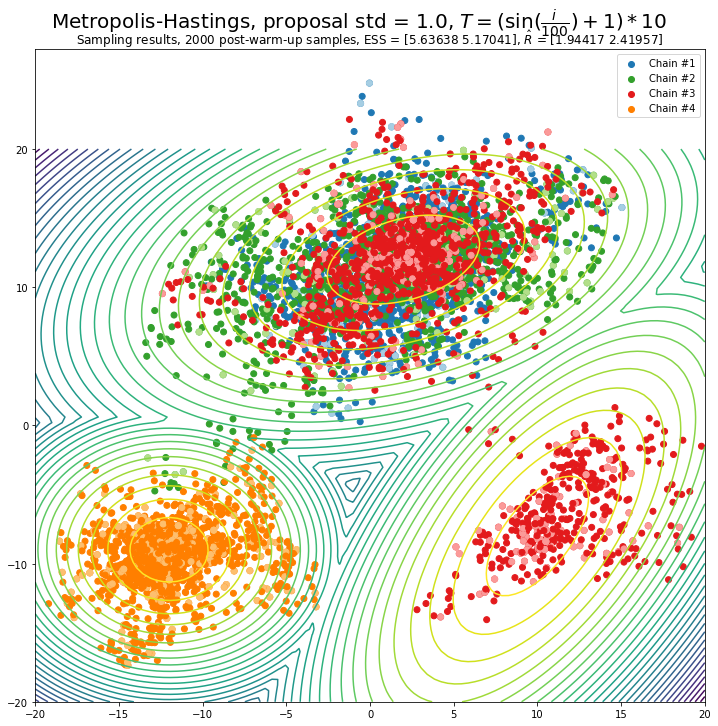

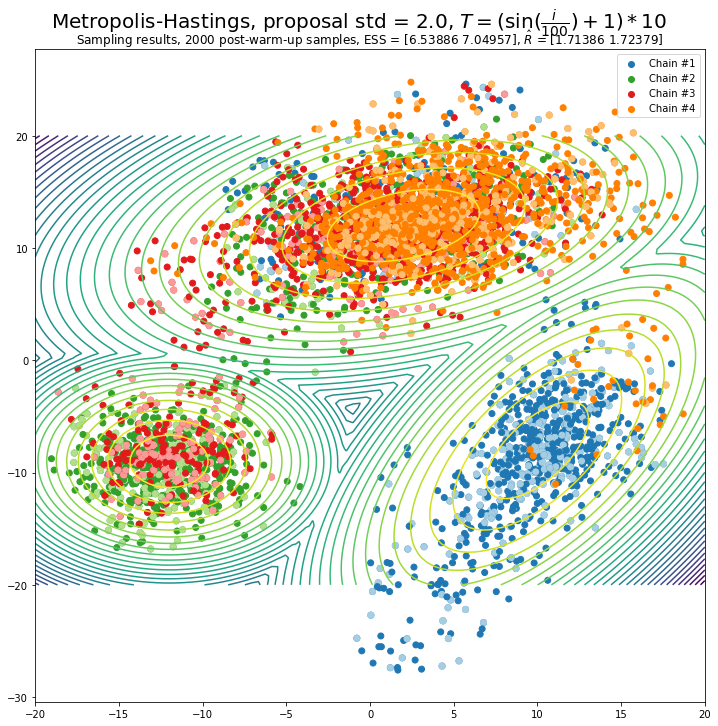

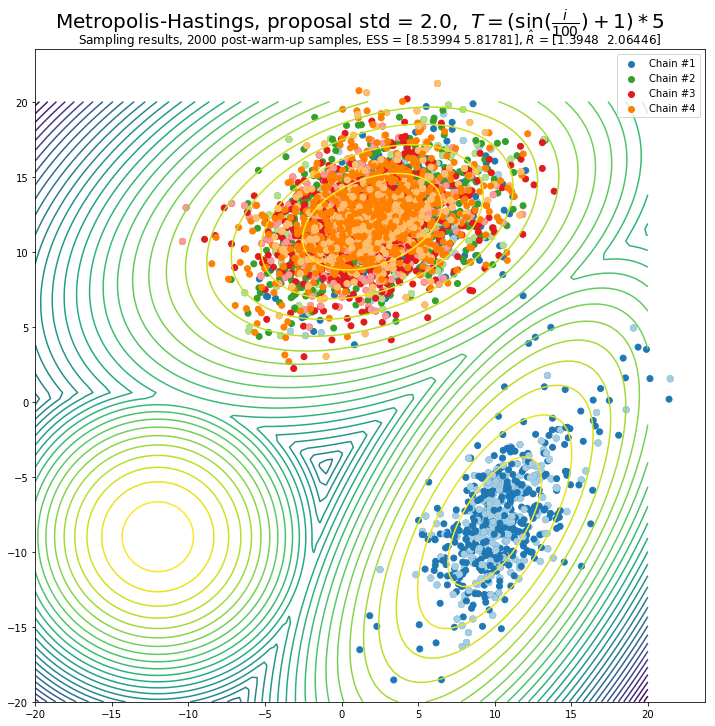

In [32]:
for proposal_std in (1.0, 2.0):
    plot_results(results, ('MH', proposal_std, 'sinusodial temp'),
                 f'Metropolis-Hastings, proposal std = {proposal_std}, $T = (\\sin(\\frac{{i}}{{100}}) + 1 )* 10$',
                 plot_func=MH_two_d_countour_plot)
    
plot_results(results, ('MH', proposal_std, 'alternative sinusodial temp'),
                 f'Metropolis-Hastings, proposal std = {proposal_std},  $T = (\\sin(\\frac{{i}}{{100}}) + 1 )* 5$',
                 plot_func=MH_two_d_countour_plot)

We get some nice behavior, and it looks a little bit less noisy than the highest temperature setting $T = 16$, but it would require further work to meaningfully distinguish between the two. However, the last setting completley missed one of the modes.

If playing with the temperature doesn't help HMC, one last resort that should help is formally relaxing the problem. This is obviously impossible to do in most real-world settings, without innate knowledge of the problem, but may be possible in some cases (for instance, if the end result is a normal likelihood around a mean, where the standard deviation represents error, allowing for additiona lerror by increasing it). 

To relax the problem we scale the covariance matrices of all three modes: 

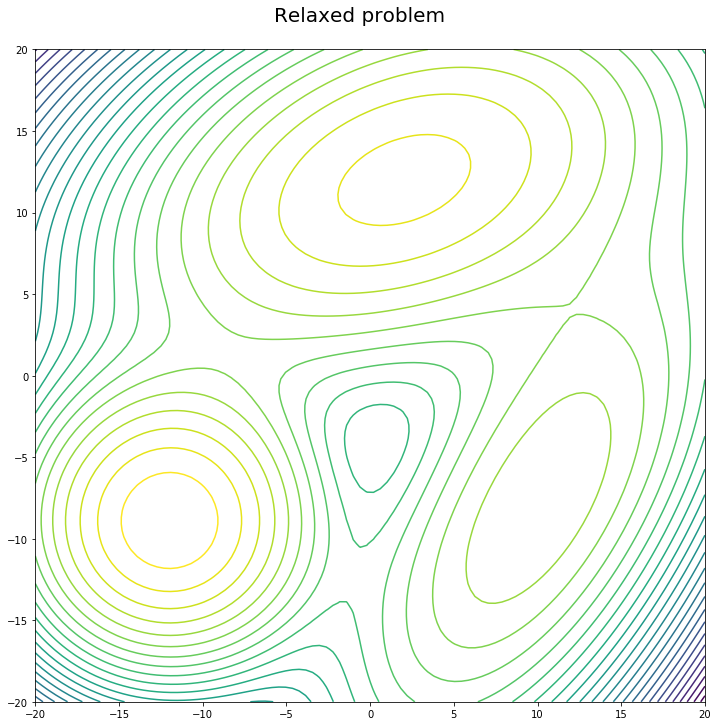

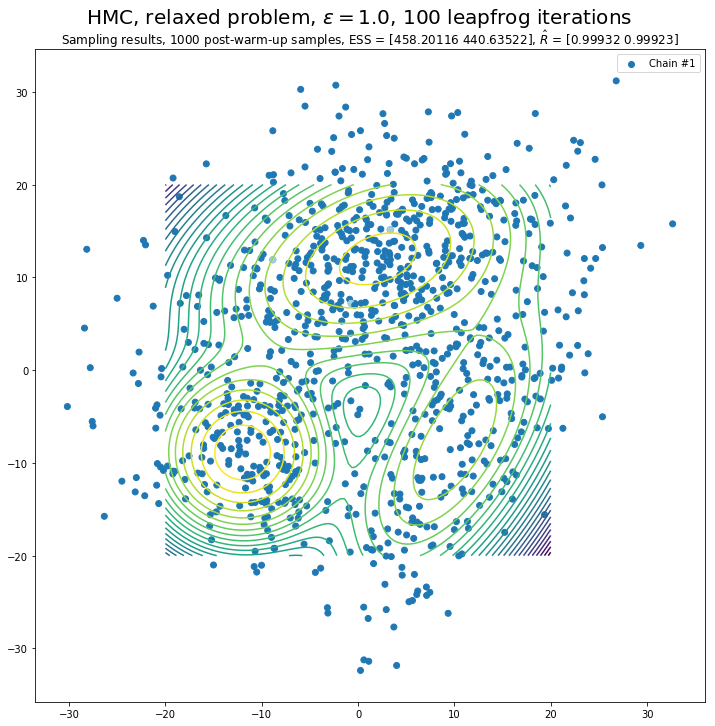

In [38]:
cov_scale = 50.0

def relaxed_two_d_mixture_gaussians(theta):
    return hmc.np.log(0.5 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([2, 12]),
                                                          cov=hmc.np.array(([[2, 0.5], [0.5, 1]])) * cov_scale) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([10, -8]),
                                                           cov=hmc.np.array(([[1, 0.9], [0.9, 2]])) * cov_scale) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([-12, -9]),
                                                           cov=hmc.np.array(([[0.5, 0], [0, 0.5]])) * cov_scale))

two_d_countour_plot(relaxed_two_d_mixture_gaussians, 0, [-20, 20], [-20, 20], None, None,
                   f'Relaxed problem')

epsilon = 1.0
L = 100
temperature = 1.0
momentum_std = 1.0
plot_results(results, ('HMC-relaxed', epsilon, L, temperature, momentum_std), 
             f'HMC, relaxed problem, $\\epsilon = {epsilon}$, {L} leapfrog iterations',
            density=relaxed_two_d_mixture_gaussians)

What about a less strongly relaxed version of the problem?

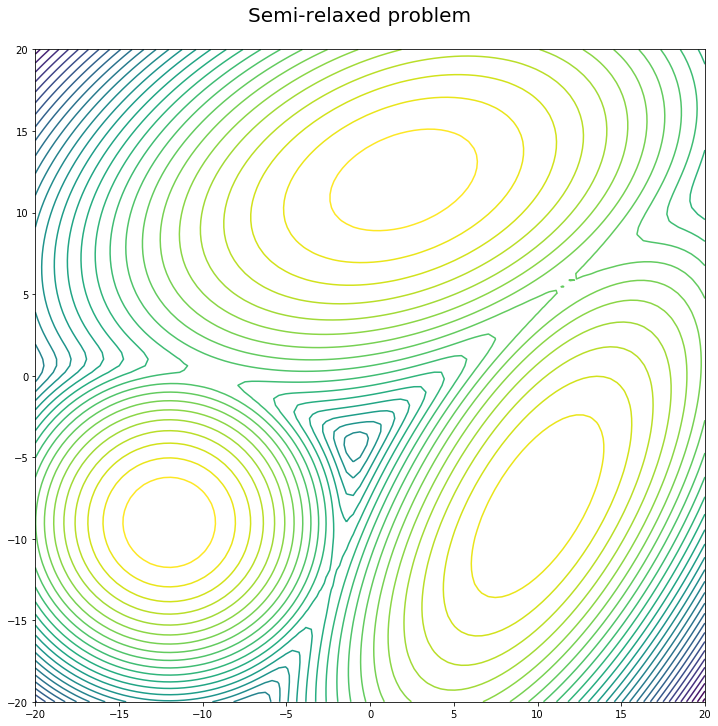

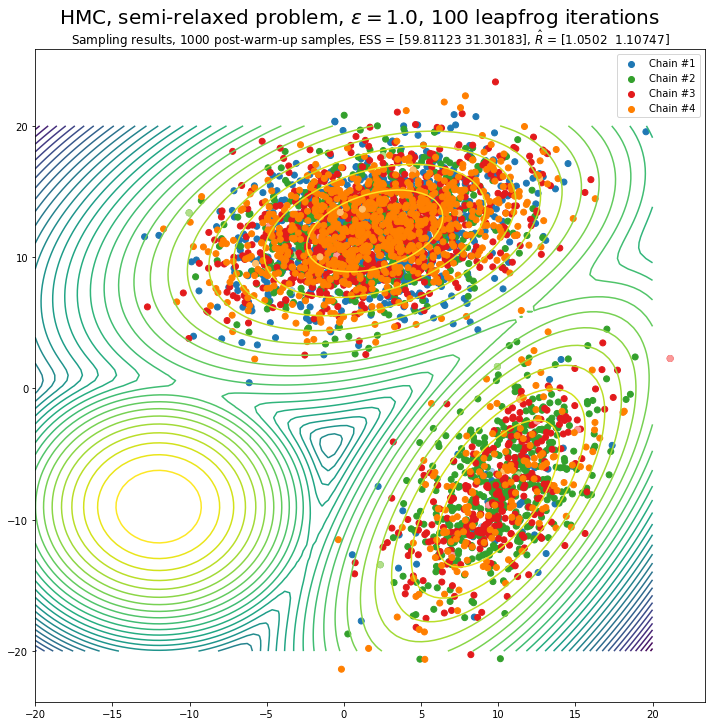

In [40]:
cov_scale = 10.0

def semi_relaxed_two_d_mixture_gaussians(theta):
    return hmc.np.log(0.5 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([2, 12]),
                                                          cov=hmc.np.array(([[2, 0.5], [0.5, 1]])) * cov_scale) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([10, -8]),
                                                           cov=hmc.np.array(([[1, 0.9], [0.9, 2]])) * cov_scale) + \
                  0.25 * hmc.stats.multivariate_normal.pdf(theta, mean=hmc.np.array([-12, -9]),
                                                           cov=hmc.np.array(([[0.5, 0], [0, 0.5]])) * cov_scale))

two_d_countour_plot(semi_relaxed_two_d_mixture_gaussians, 0, [-20, 20], [-20, 20], None, None,
                   f'Semi-relaxed problem')

epsilon = 1.0
L = 100
temperature = 1.0
momentum_std = 1.0
plot_results(results, ('HMC-semi-relaxed', epsilon, L, temperature, momentum_std), 
             f'HMC, semi-relaxed problem, $\\epsilon = {epsilon}$, {L} leapfrog iterations',
            density=semi_relaxed_two_d_mixture_gaussians)

Not as well, but substantially better than the original problem. 

However, what can we do for HMC that doesn't require innate knowledge of the problem? Something Alex mentioned in class with respect to Stan's toy problem was that he increased the momentum standard deviation, and that appeared to help. Let's try that as well. This would allow us to nudge further away at each iteration:

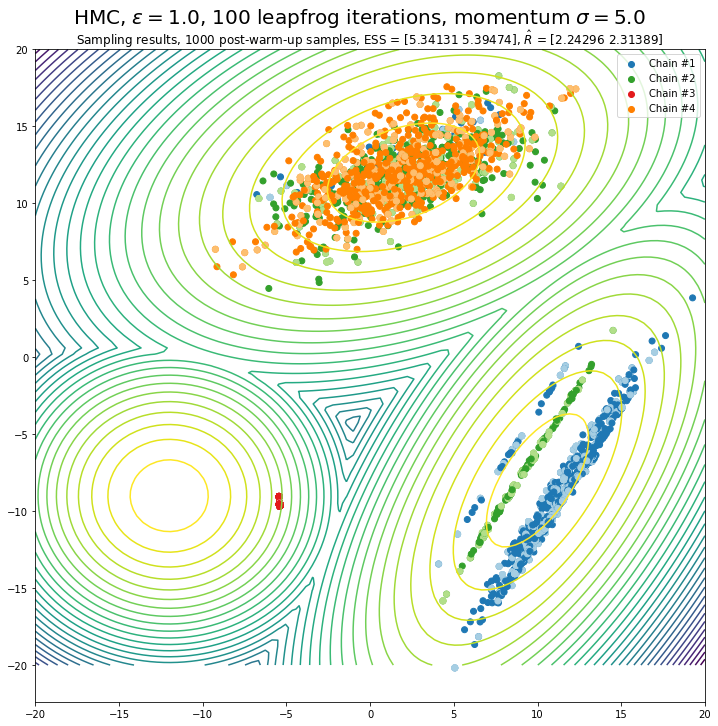

In [44]:
epsilon = 1.0
L = 100
momentum_std = 5.0
plot_results(results, ('HMC', epsilon, L, momentum_std), 
             f'HMC, $\\epsilon = {epsilon}$, {L} leapfrog iterations, momentum $\\sigma = {momentum_std}$')

The effective sample size and $\hat{R}$ drop substantially, but we get much better exploration performance! Let's explore other parameter settings and see what happens:

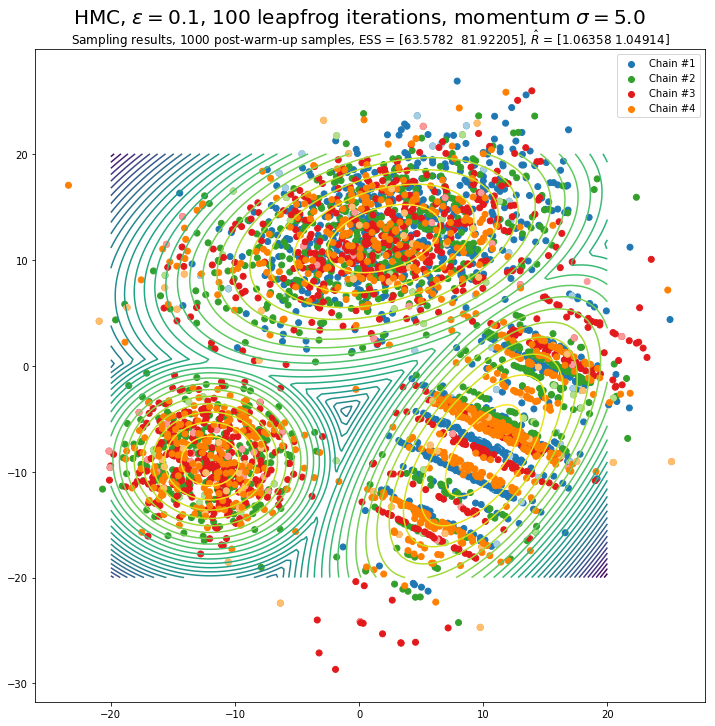

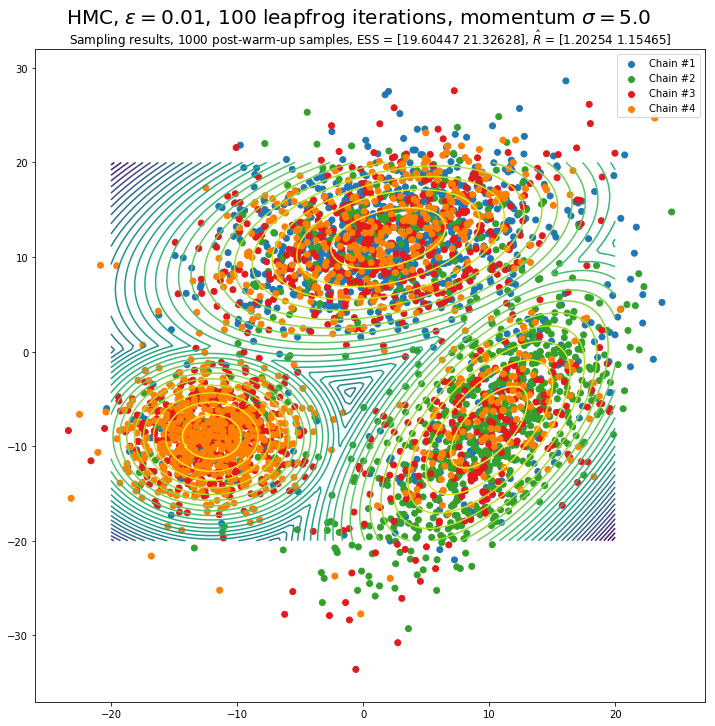

In [45]:
L = 100
momentum_std = 5.0
for epsilon in (0.1, 0.01):
    plot_results(results, ('HMC', epsilon, L, momentum_std), 
             f'HMC, $\\epsilon = {epsilon}$, {L} leapfrog iterations, momentum $\\sigma = {momentum_std}$')
    

This look delightfully better, although the effective sample size is much, much lower than before (presumably due to vastly increased variances), and there appears to be a sweetspot of some sort with respect to $\epsilon$, as 0.1 functions better than both 1.0 and 0.01. 

Smaller values of $\epsilon$ with the standard proposal momentum (1.0) fail to recover this lovely exploratory behavior. What about the precise value of the momentum $\sigma$? How sensitive are we to it? 

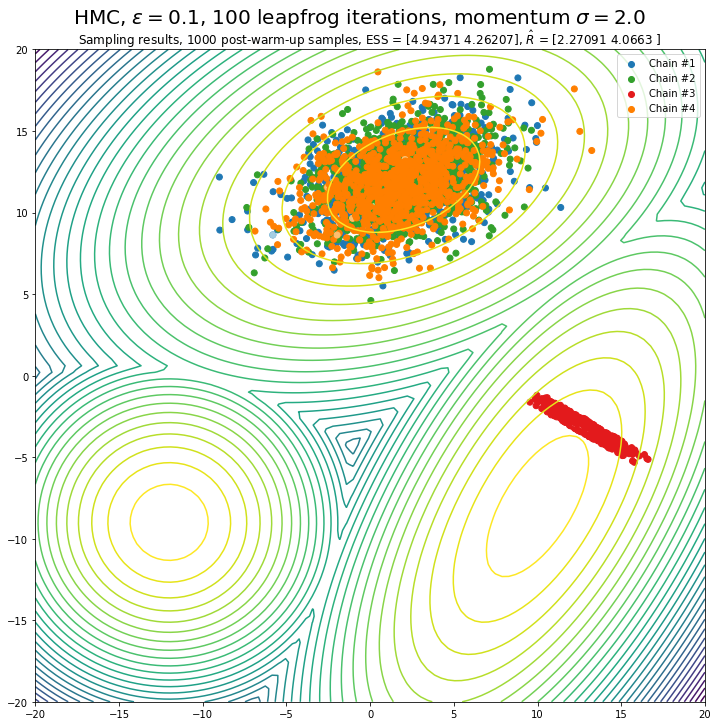

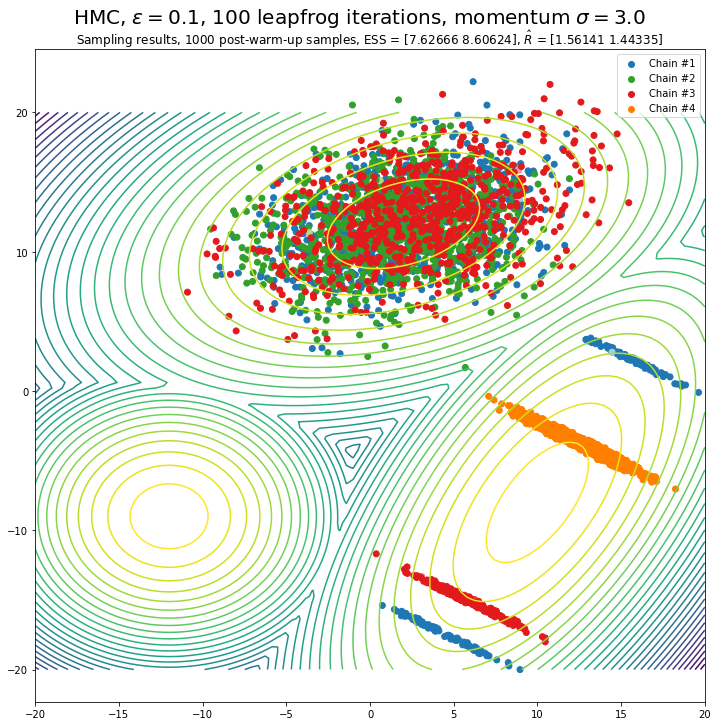

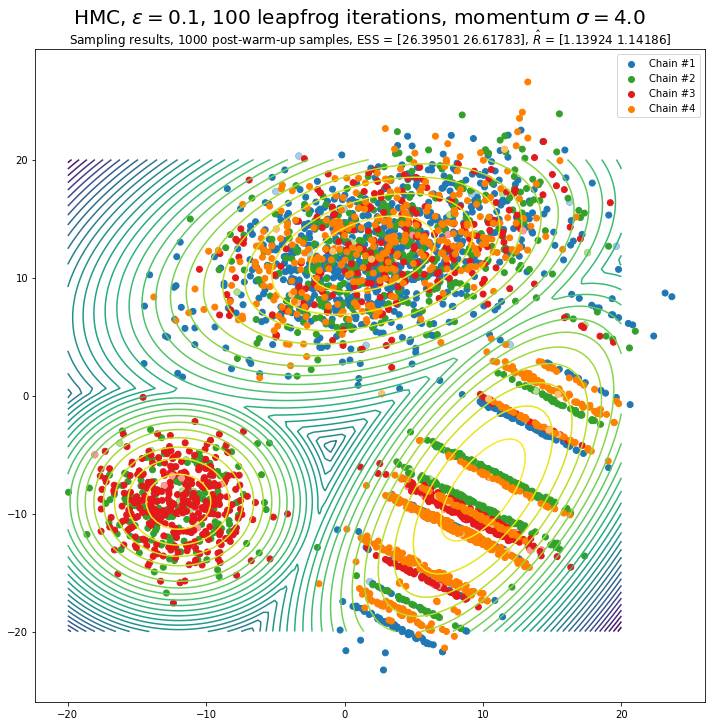

In [47]:
epsilon = 0.1
L = 100
for momentum_std in (2.0, 3.0, 4.0):
    plot_results(results, ('HMC', epsilon, L, momentum_std), 
             f'HMC, $\\epsilon = {epsilon}$, {L} leapfrog iterations, momentum $\\sigma = {momentum_std}$')

The answer appears to be rather sensitive. We get this interesting smearing behavior, but below $\epsilon = 4.0$ we see much worse exploring. I also tried a more weird, yet symmetric proposal distribution for the momentum variables ($q \sim 0.5 \mathcal{N}(\mu, \sigma) + 0.5 \mathcal{N}(-\mu, \sigma)$), which unfortunately didn't appear to help much.

One final curiosity: given the amount of parameter tweaking required here, would NUTS fair any better? Let's dive straight into the plots:

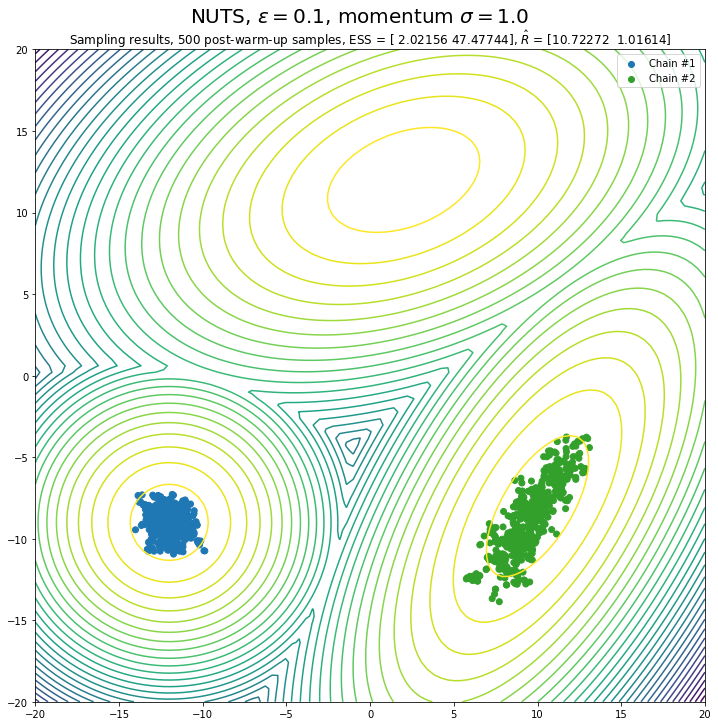

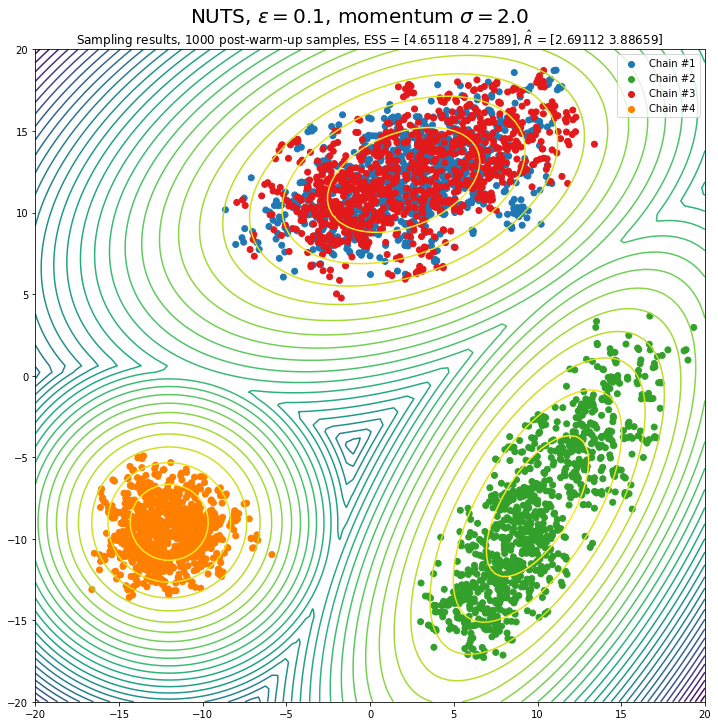

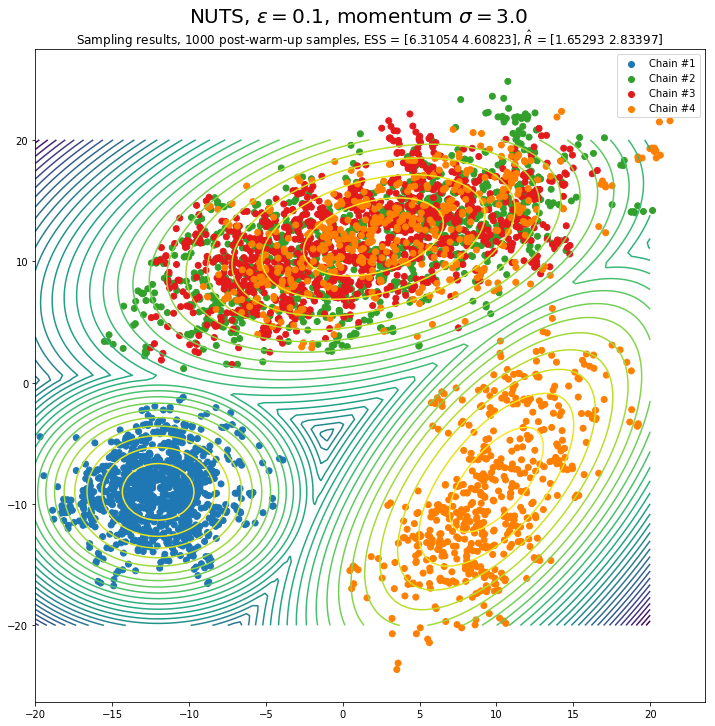

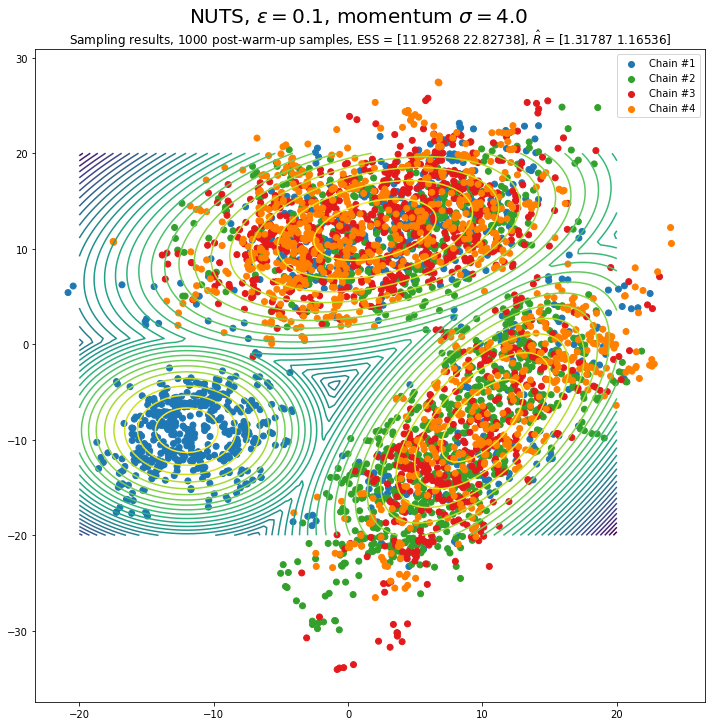

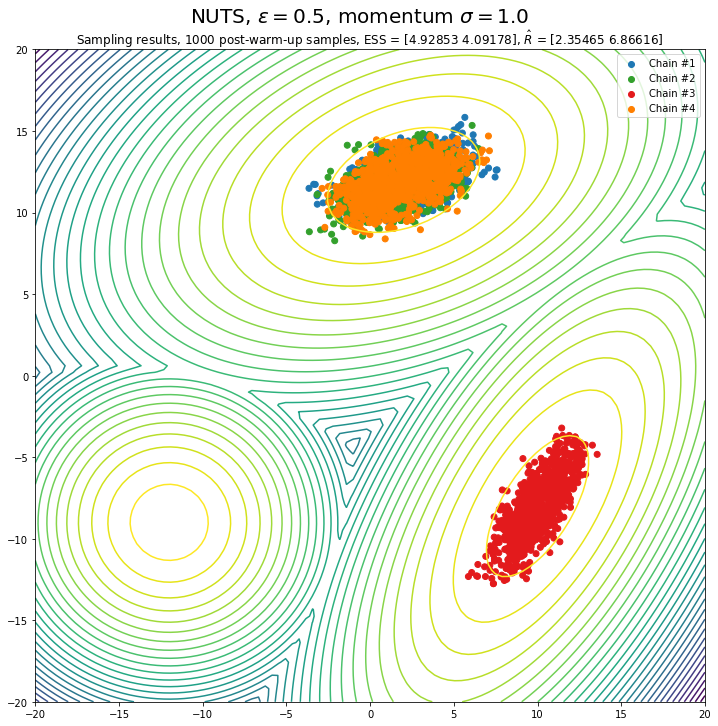

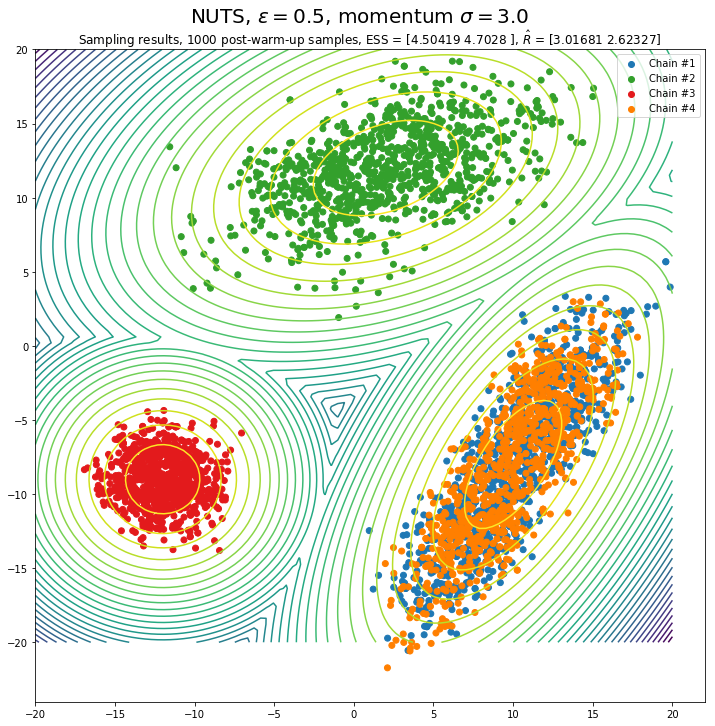

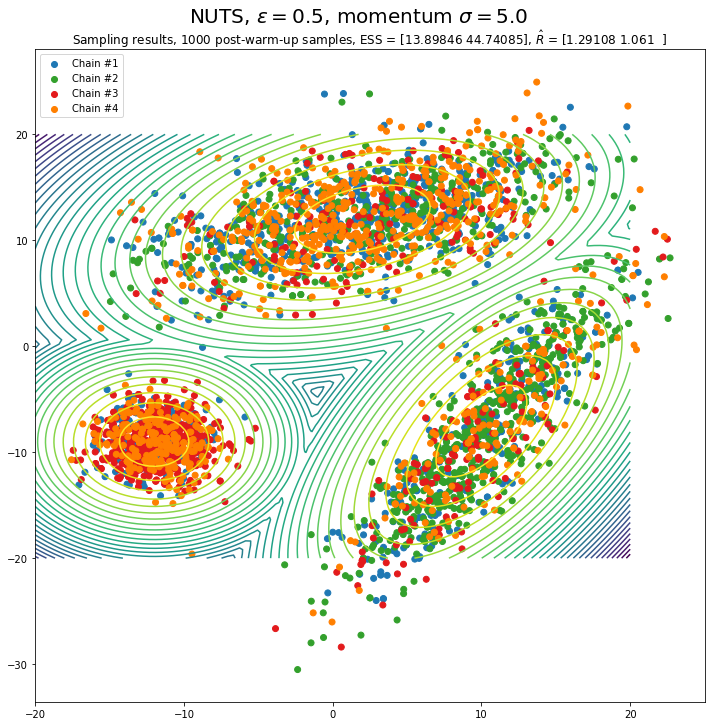

In [50]:
epsilon = 0.1
for momentum_std in (1.0, 2.0, 3.0, 4.0):
    plot_results(results, ('NUTS', epsilon, None, momentum_std), 
             f'NUTS, $\\epsilon = {epsilon}$, momentum $\\sigma = {momentum_std}$')
    
epsilon = 0.5
for momentum_std in (1.0, 3.0, 5.0):
    plot_results(results, ('NUTS', epsilon, None, momentum_std), 
             f'NUTS, $\\epsilon = {epsilon}$, momentum $\\sigma = {momentum_std}$')

It appears that fairly independently of the value of $\epsilon$ chosen, with NUTS as well, higher momentum sampling variables result in both much better sampling performance, but in some cases lower values of the traditional metrics (such as $\hat{R}$). This is not theoretically surprising, since NUTS only allows to avoid selecting the value of $L$ and I didn't implement the heuristic for choosing $\epsilon$. However, it strengthens the conclusion on the impact of the momentum parameter, which was the only way to allow HMC to sample from all three modes, other than formally relaxing the problem.

## Conclusions:

1. Changing the temeprature is a good debugging tool for Metropolis-Hastings. If the samples with higher temperature look vastly different than with a lower temperature, it's cause to investigate further.

2. The notion of a temperature schedule for Metropolis-Hastings is interesting, and would be fun to explore further at some point.

3. Relaxing the problem makes it easier, unsurprisingly, but requires innate knowldge of the density to be sampled from that isn't always plausible in real-world problems.

4. The value of the momentum parameter appears to substantially impact the quality of exploration performed by HMC. It is very curious that the literature never mentions tweaking it. Perhaps if the parameters are all nornalized to take typical values that remsemble a standard Gaussian, it matters less? This is rather curious. This option is also availble regardless of problem structure and specifics, making it all the more powerful.

5. NUTS is equally sensitive to this choice of parameter, making it all the more curious it doesn't appear to be discussed in the literature. It's certainly something we could investgiate further. 

6. Perhaps there's room to automatically tune the values of momentum, or anneal them over sampling? Or perform two stages - one in which we 'explore' at a higher momentum to find potential mode, and another in which we 'exploit' at a lower momentum starting at each potential mode, and continuing until they mix? This would be far more dynamic and adaptive than standard approaches, 

### Process notes:

* Saving aside results is good. Choosing in advance a standard format to save aside results is better, and would have made my life easier (I changed key formats in the results pickle file several times).

* Writing my code in PyCharm and python files while graphing in notebooks appears to be a good balance of convenience and debugging/code completion power. 

* The code for this project is all available at 

## References: